In [4]:
import pandas as pd
import numpy as np
import matplotlib
from matplotlib import pyplot as plt
import seaborn as sns
df = pd.read_csv('ReadyPragAirBnB.csv',sep=';', index_col=0)
df.head(5)

,RoomID,Name,HostID,Neighbourhood,RoomType,Price,MinNights,NumReviews,RoomsPerHost,Availibility,Location,Latitude,Longtitude,PriceCategory
0,25092602,❤️AMAZING APARTMENT WITH NETFLIX NEAR CENTRE❤️,189676842,Praha 3,Entire home/apt,1310,1,79,1,172,"Czech republic, Prague, Praha 3",50.086376,14.444495,střední
1,25197350,Room in beautiful area close to Prague Castle,28365945,Praha 6,Private room,763,1,2,1,0,"Czech republic, Prague, Praha 6",50.083104,14.369196,nízká
2,25470062,Luxury apartment in the center of Prague,47717433,Praha 2,Entire home/apt,1071,2,84,1,109,"Czech republic, Prague, Praha 2",50.073298,14.439128,střední
3,25547218,Much More For Your Money In Beautiful Letná,21217319,Praha 7,Entire home/apt,2074,1,21,1,0,"Czech republic, Prague, Praha 7",50.102008,14.417981,vysoká
4,25907826,Apartment near city transport and Prague center,119497941,Praha 4,Entire home/apt,2504,1,16,1,0,"Czech republic, Prague, Praha 4",50.057750,14.450172,vysoká


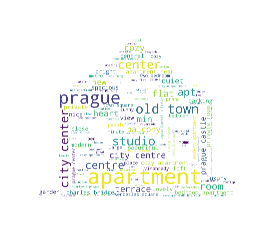

In [58]:
import matplotlib as mp
from wordcloud import WordCloud,STOPWORDS
from PIL import Image

house = np.array(Image.open('domek.jpg'))

names = ' '.join(df['Name'].str.lower().values)
wordcloud = WordCloud(background_color='white',
                        height=900,
                        width=800,
                        scale=20, 
                        prefer_horizontal=0.9999,
                        mask=house 
                     ).generate(names)
plt.figure(figsize=[8, 4])
plt.imshow(wordcloud)
plt.axis('off')
plt.savefig('WordName.jpg', dpi=900, bbox_inches='tight', quality=95)
plt.show()

In [202]:
data = df.Name.str.split(expand=True).stack().value_counts()
wordFreq = pd.DataFrame(data, columns=['Frequency'])
wordFreq.head(10)

,Frequency
in,2953
Prague,2175
Apartment,2123
apartment,1988
the,1818
with,1354
to,1211
-,1137
center,1004
room,993


In [234]:
import nltk
from nltk.corpus import stopwords
import re
import matplotlib
import matplotlib.pyplot as plt
import pandas as pd
import nltk

nltk.download('stopwords')
nltk.download('punkt')
stopwords = stopwords.words('english')
top_N = 10

cleanTxt = df['Name'].apply(lambda x: [item for item in x if item not in stopwords])
txtFreq = cleanTxt.str.split(expand=True).stack().value_counts()

txtFreq.head(5)


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\mates\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\mates\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


Series([], dtype: int64)

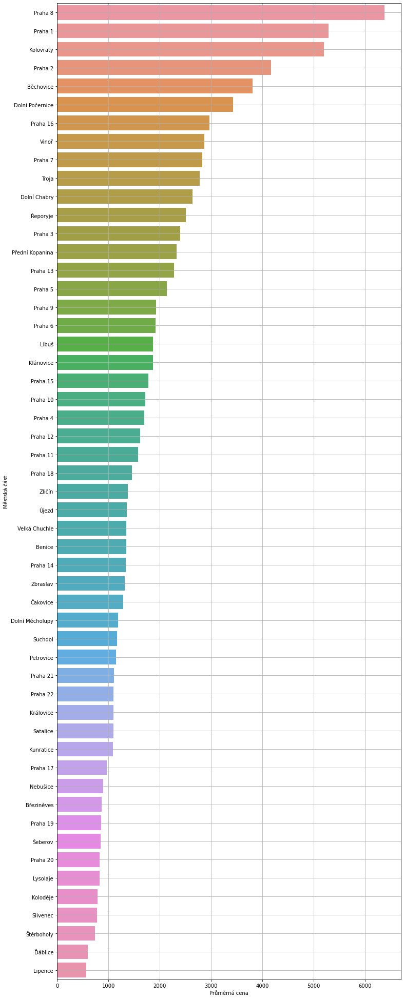

In [36]:
cityParts = list(df['Neighbourhood'].unique())

partPrice=[]

for i in cityParts:
    x=df[df.Neighbourhood==i]
    avgPrice=sum(x.Price)/len(x)
    partPrice.append(avgPrice)

df1=pd.DataFrame({'cityParts':cityParts,'partPrice':partPrice})
new_index=df1.partPrice.sort_values(ascending=False).index.values
sorted_data=df1.reindex(new_index)

plt.figure(figsize=(12,35))
ax=sns.barplot(x=sorted_data.partPrice,y=sorted_data.cityParts)
plt.grid(True)
plt.xlabel('Průměrná cena')
plt.ylabel('Městská část')
plt.savefig('CityPartsPrice.png', dpi=1500)

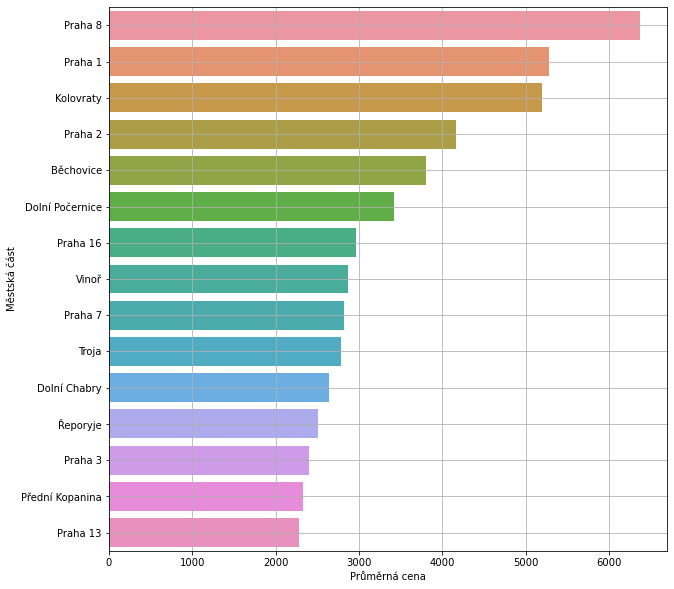

In [213]:
cityParts = list(df['Neighbourhood'].unique())

partPrice=[]

for i in cityParts:
    x=df[df.Neighbourhood==i]
    avgPrice=sum(x.Price)/len(x)
    partPrice.append(avgPrice)

df1=pd.DataFrame({'cityParts':cityParts,'partPrice':partPrice})
new_index=df1.partPrice.sort_values(ascending=False).index.values[:15]
sorted_data=df1.reindex(new_index)

plt.figure(figsize=(10,10))
ax=sns.barplot(x=sorted_data.partPrice,y=sorted_data.cityParts)
plt.grid(True)
plt.xlabel('Průměrná cena')
plt.ylabel('Městská část')
plt.savefig('CityPartsPrice15.png', dpi=1500)

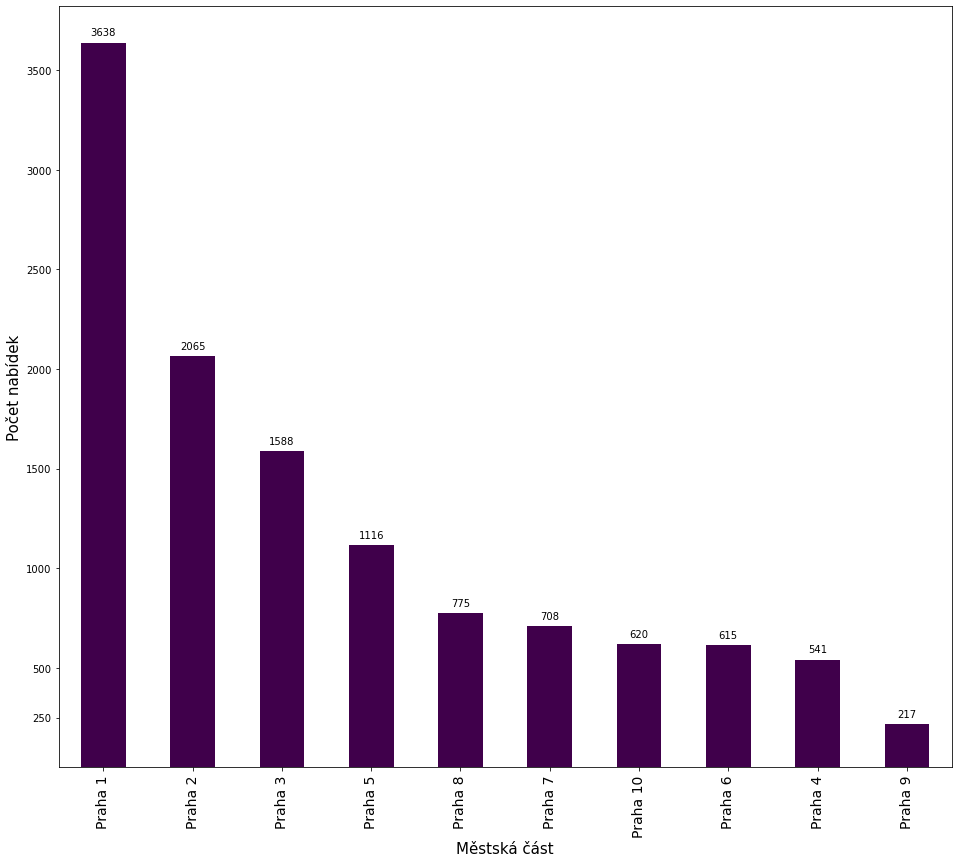

In [49]:
#městské části

fig = plt.figure(figsize=(16,14))

ax = df.groupby('Neighbourhood').nunique()['RoomID'].sort_values(ascending=False)[:10].plot(kind='bar',colormap='PRGn')
def barValuesVert(ax, spacing=5):
  
    for rect in ax.patches:
        y_value = rect.get_height()
        x_value = rect.get_x() + rect.get_width() / 2
        space = spacing
        va = 'bottom'   
      
            
        label = "{:d}".format(y_value)
        ax.annotate(
            label,                     
            (x_value, y_value),         
            xytext=(0, space),          
            textcoords="offset points", 
            ha='center',                
            va=va)                      

barValuesVert(ax)
plt.ylabel('Počet nabídek',fontsize=15) 
plt.xlabel('Městská část',fontsize=15)
plt.xticks(fontsize = 14)
plt.grid
plt.yticks([250,500,1000,1500,2000,2500,3000,3500])

plt.savefig('CityParts10.png', dpi=1500)
plt.show()



AttributeError: 'Series' object has no attribute 'rating'

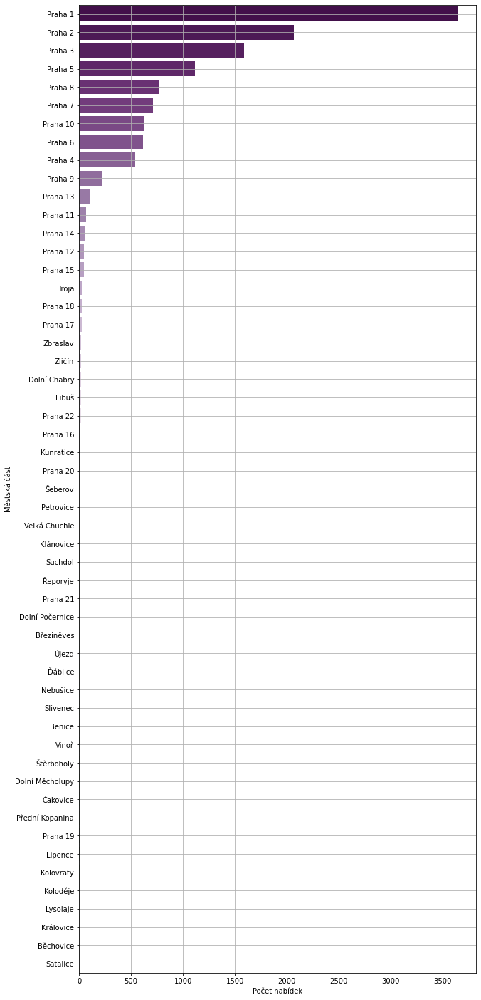

In [47]:
#počet nabídek, všechny městské části
plt.figure(figsize=(10,25))
ax=sns.countplot(y=df['Neighbourhood'],order=df['Neighbourhood'].value_counts().index,palette='PRGn')
   
plt.grid(True)
plt.xlabel('Počet nabídek')
plt.ylabel('Městská část')
plt.show()
plt.savefig('CityPartsOffers.png', dpi=1500)

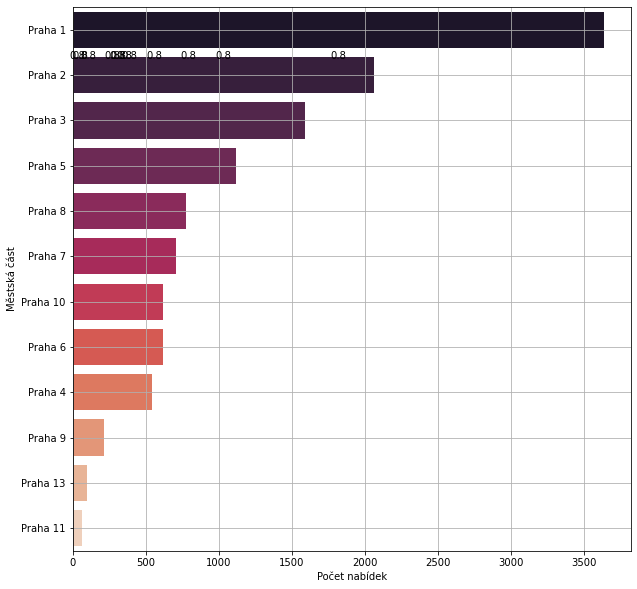

In [39]:
#počet nabídek, prvních pár
plt.figure(figsize=(10,10))
ax=sns.countplot(y=df['Neighbourhood'],order=df['Neighbourhood'].value_counts().index[:12],palette='rocket')

plt.grid(True)
plt.xlabel('Počet nabídek')
plt.ylabel('Městská část')

plt.savefig('CityPartsOffers12.png', dpi=1500)

In [35]:
#Všechny městské části s počtem nabídek
df.groupby('Neighbourhood').count()['RoomID'].sort_values(ascending=False)



Neighbourhood
Praha 1            3638
Praha 2            2065
Praha 3            1588
Praha 5            1116
Praha 8             775
Praha 7             708
Praha 10            620
Praha 6             615
Praha 4             541
Praha 9             217
Praha 13             99
Praha 11             67
Praha 14             56
Praha 12             49
Praha 15             45
Praha 18             25
Troja                25
Praha 17             25
Zbraslav             20
Zličín               20
Dolní Chabry         17
Praha 22             16
Libuš                16
Praha 16             15
Kunratice            14
Praha 20             13
Šeberov              12
Velká Chuchle        12
Petrovice            12
Klánovice            11
Suchdol              11
Řeporyje             11
Praha 21              9
Dolní Počernice       9
Újezd                 7
Březiněves            7
Ďáblice               7
Nebušice              6
Vinoř                 5
Slivenec              5
Benice                5
Do

([<matplotlib.axis.XTick at 0x1a319366ca0>,
 <a list of 10 Text major ticklabel objects>)

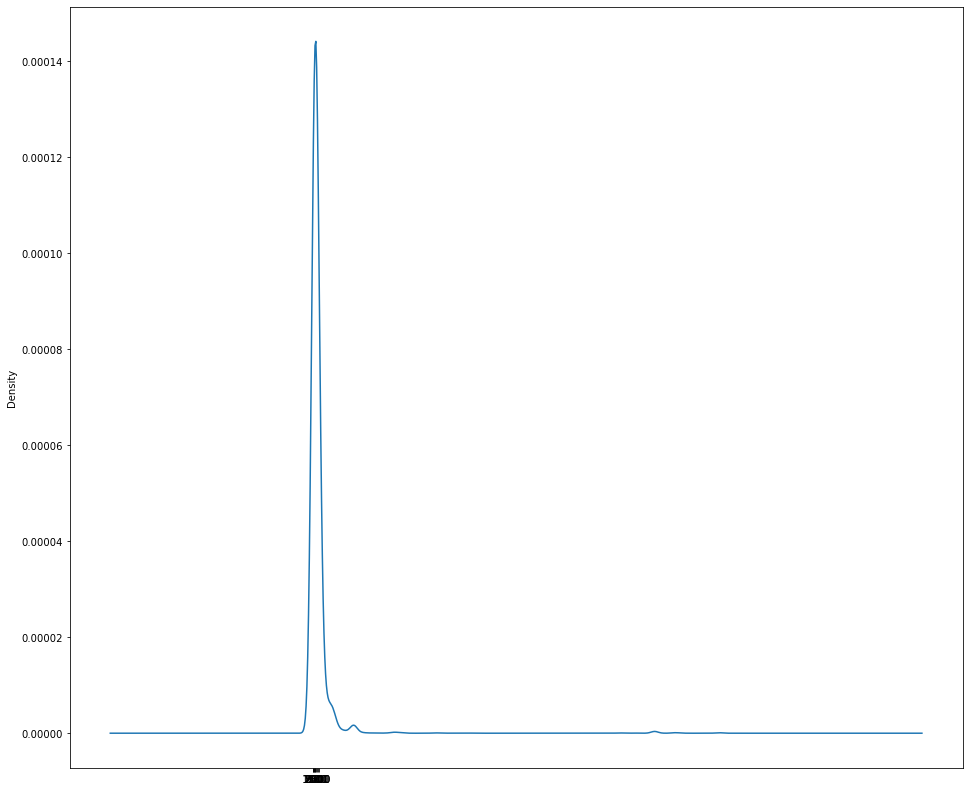

In [134]:
fig = plt.figure(figsize=(16,14))
df['Price'].plot(kind='kde')
plt.xticks([50,100,250,500,1000,1500,2000,2500,3000,3500])

In [147]:
df.groupby('Neighbourhood').mean()['Price'].sort_values(ascending=False)



Neighbourhood
Praha 8            6376.805161
Praha 1            5283.863661
Kolovraty          5198.333333
Praha 2            4163.605327
Běchovice          3810.000000
Dolní Počernice    3423.333333
Praha 16           2967.133333
Vinoř              2867.200000
Praha 7            2824.896893
Troja              2781.440000
Dolní Chabry       2635.117647
Řeporyje           2506.909091
Praha 3            2399.100126
Přední Kopanina    2325.666667
Praha 13           2277.353535
Praha 5            2136.181004
Praha 9            1930.359447
Praha 6            1914.904065
Libuš              1870.812500
Klánovice          1868.454545
Praha 15           1776.133333
Praha 10           1713.511290
Praha 4            1694.212569
Praha 12           1617.163265
Praha 11           1580.402985
Praha 18           1460.880000
Zličín             1373.100000
Újezd              1353.714286
Velká Chuchle      1349.083333
Benice             1343.000000
Praha 14           1336.339286
Zbraslav           1321.6

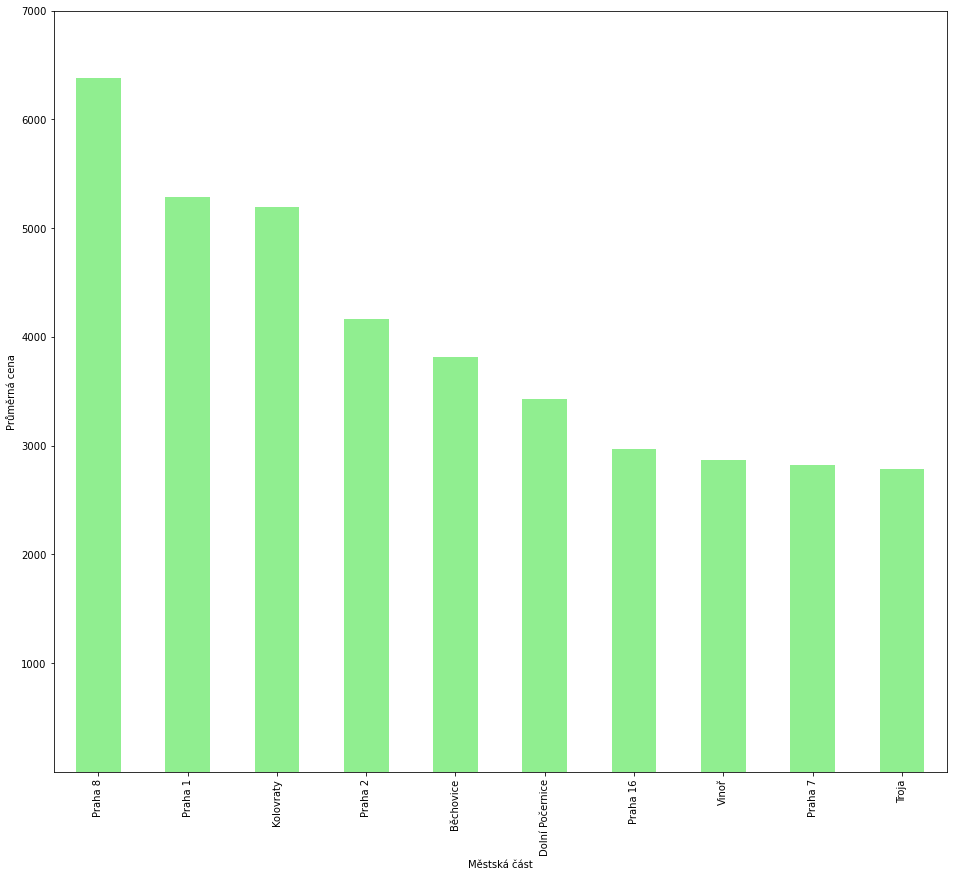

In [214]:
#ceny za městskou část
fig = plt.figure(figsize=(16,14))
df.groupby('Neighbourhood').mean()['Price'].sort_values(ascending=False)[:10].plot(kind='bar',color = 'lightgreen')
plt.ylabel('Průměrná cena') 
plt.xlabel('Městská část')

plt.yticks([1000,2000,3000,4000,5000,6000,7000])
plt.savefig('PriceCityParts.png', dpi=1500)
plt.show()

In [194]:
df['Neighbourhood'].unique()


array(['Praha 3', 'Praha 6', 'Praha 2', 'Praha 7', 'Praha 4', 'Praha 5',
       'Praha 1', 'Praha 13', 'Praha 9', 'Praha 10', 'Čakovice',
       'Praha 8', 'Benice', 'Praha 22', 'Libuš', 'Praha 11', 'Troja',
       'Újezd', 'Přední Kopanina', 'Praha 14', 'Praha 12', 'Zličín',
       'Petrovice', 'Praha 18', 'Dolní Počernice', 'Zbraslav', 'Praha 20',
       'Praha 17', 'Dolní Chabry', 'Lipence', 'Běchovice', 'Praha 15',
       'Praha 21', 'Kunratice', 'Nebušice', 'Klánovice', 'Řeporyje',
       'Suchdol', 'Dolní Měcholupy', 'Satalice', 'Ďáblice',
       'Velká Chuchle', 'Březiněves', 'Štěrboholy', 'Šeberov', 'Vinoř',
       'Slivenec', 'Kolovraty', 'Praha 19', 'Praha 16', 'Koloděje',
       'Královice', 'Lysolaje'], dtype=object)

In [195]:
df['Neighbourhood'].nunique()


53

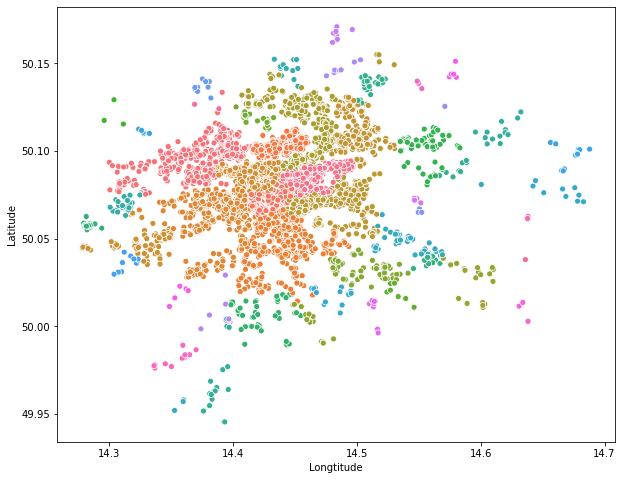

In [105]:
#nabídky dle městské části
plt.figure(figsize=(10,8))

      
sns.scatterplot(df.Longtitude,df.Latitude,hue=df.Neighbourhood,legend=False)
plt.ioff()
plt.savefig('CityPartsPints.png', dpi=1500)

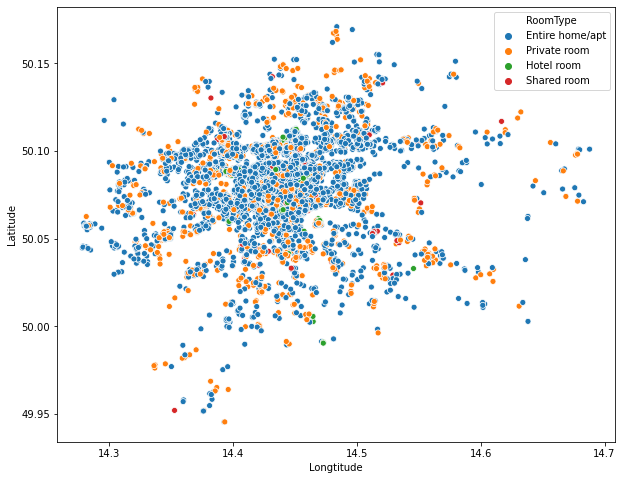

In [181]:
#nabídky dle městské části
plt.figure(figsize=(10,8))

      
sns.scatterplot(df.Longtitude,df.Latitude,hue=df.RoomType)
plt.ioff()
plt.savefig('RoomTypes.png', dpi=1500)

In [7]:
import folium
from folium.plugins import HeatMap


mapHeat = folium.Map([50.06,14.45],zoom_start=11)
HeatMap(df[['Latitude','Longtitude']].dropna(),radius=8,gradient={0.2:'blue',0.4:'purple',0.6:'orange',1.0:'red'}).add_to(mapHeat)

mapHeat.save( 'HeatMap.html')
display(mapHeat)

In [8]:
from folium.plugins import MarkerCluster
mapPoint = folium.Map([50.06,14.45],zoom_start=11)

    
for index, row in df.iterrows():
    if df.PriceCategory[index] == 'nízká':
        folium.CircleMarker( location=[df.Latitude[index], df.Longtitude[index]],color='blue', radius=1 ).add_to( mapPoint )
    elif df.PriceCategory[index] == 'střední':
        folium.CircleMarker( location=[df.Latitude[index], df.Longtitude[index]],color='orange', radius=1 ).add_to( mapPoint )
    elif df.PriceCategory[index] == 'vysoká':
        folium.CircleMarker( location=[df.Latitude[index], df.Longtitude[index]],color='green', radius=1 ).add_to( mapPoint )
    elif df.PriceCategory[index] == 'nejvyšší':
        folium.CircleMarker( location=[df.Latitude[index], df.Longtitude[index]],color='red', radius=1 ).add_to( mapPoint )
        
        
mapPoint.save( 'PointMap.html')
display(mapPoint)

In [9]:
import folium
from folium.plugins import MarkerCluster
mapPoint = folium.Map([50.06,14.45],zoom_start=11)

    
for index, row in df.iterrows(): 
    if df.PriceCategory[index] == 'nejvyšší':
        folium.CircleMarker( location=[df.Latitude[index], df.Longtitude[index]],color='red', radius=1 ).add_to( mapPoint )
        
        
mapPoint.save( 'PointMapHighest.html')
display(mapPoint)

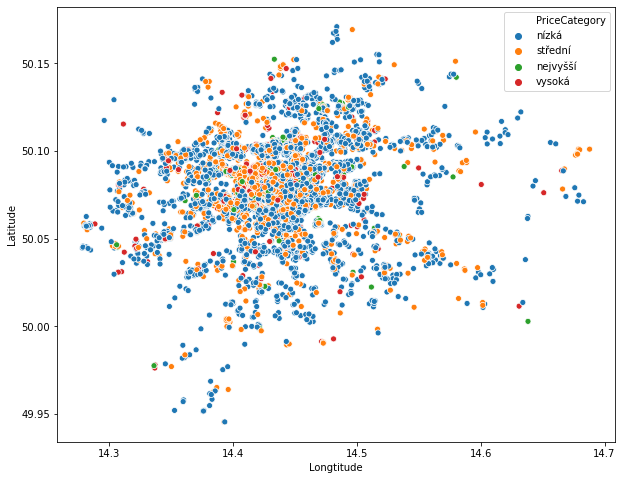

In [205]:
#nabídky dle cenové kategorie
plt.figure(figsize=(10,8))

      
sns.scatterplot(df.Longtitude,df.Latitude,hue=df.PriceCategory)
plt.ioff()
plt.savefig('RoompriceCat.png', dpi=1500)

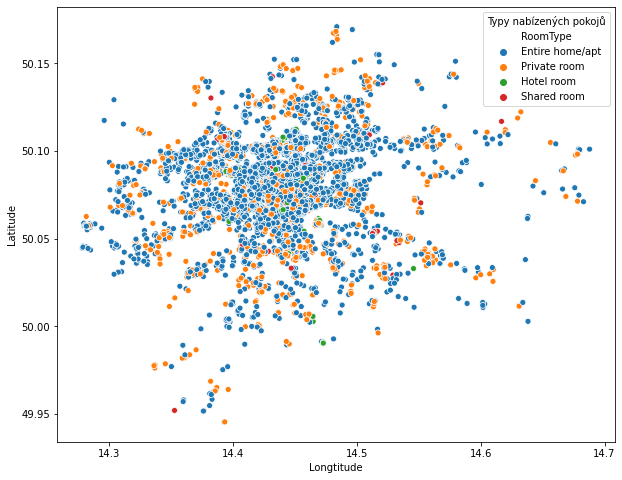

In [119]:
#Typy nabídek
plt.figure(figsize=(10,8))    
sns.scatterplot(df.Longtitude,df.Latitude, hue=df.RoomType, legend='full')
plt.legend(title='Typy nabízených pokojů')
plt.savefig('RoomTypesPints.png', dpi=1500)

In [120]:
from folium.plugins import MarkerCluster
mapPoint = folium.Map([50.06,14.45],zoom_start=11)

    
for index, row in df.iterrows():
    if df.RoomType[index] == 'Entire home/apt':
        folium.CircleMarker( location=[df.Latitude[index], df.Longtitude[index]],color='blue', radius=1 ).add_to( mapPoint )
    elif df.RoomType[index] == 'Private room':
        folium.CircleMarker( location=[df.Latitude[index], df.Longtitude[index]],color='orange', radius=1 ).add_to( mapPoint )
    elif df.RoomType[index] == 'Hotel room':
        folium.CircleMarker( location=[df.Latitude[index], df.Longtitude[index]],color='green', radius=1 ).add_to( mapPoint )
    elif df.RoomType[index] == 'Shared room':
        folium.CircleMarker( location=[df.Latitude[index], df.Longtitude[index]],color='red', radius=1 ).add_to( mapPoint )
        
        
mapPoint.save( 'RoomTypesMap.html')
display(mapPoint)

In [121]:
from folium.plugins import MarkerCluster
mapPoint = folium.Map([50.06,14.45],zoom_start=11)

    
for index, row in df.iterrows():
    
    if df.RoomType[index] == 'Private room':
        folium.CircleMarker( location=[df.Latitude[index], df.Longtitude[index]],color='orange', radius=1 ).add_to( mapPoint )
   
        
mapPoint.save( 'PrivateRoomMap.html')
display(mapPoint)

In [123]:
from folium.plugins import MarkerCluster
mapPoint = folium.Map([50.06,14.45],zoom_start=11)

    
for index, row in df.iterrows():
    if df.RoomType[index] == 'Entire home/apt':
        folium.CircleMarker( location=[df.Latitude[index], df.Longtitude[index]],color='blue', radius=1 ).add_to( mapPoint )
        
mapPoint.save( 'ApartMap.html')
display(mapPoint)

In [56]:
import plotly.express as ex
#typy nabídek pie chart


offerTypes = df.groupby('RoomType').nunique()['RoomID'].sort_values(ascending=False)
typeNames = df.RoomType.unique()
fig = ex.pie(df, values=offerTypes, names=typeNames,hole=0.4,color=typeNames, color_discrete_map={'Entire home/apt':'#1a53ff',
                                 'Private room':'#ff9900',
                                 'Hotel room':'green',
                                 'Shared room':'red'})
fig.update_traces(textinfo='percent+value')
fig.show()
fig.write_image('typesPieChart.png')

In [142]:
df.groupby('RoomType').nunique()['RoomID'].sort_values(ascending=False)

RoomType
Entire home/apt    9659
Private room       2309
Hotel room          416
Shared room         181
Name: RoomID, dtype: int64

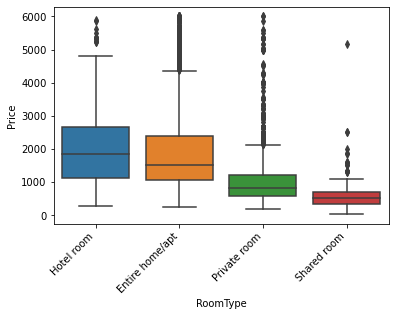

In [52]:
sort_price = df.loc[(df.Price <= 6000) & (df.Price > 0)]\
                    .groupby('RoomType')['Price']\
                    .median()\
                    .sort_values(ascending=False)\
                    .index
sns.boxplot(y='Price', x='RoomType', data=df.loc[(df.Price <= 6000) & (df.Price > 0)], order=sort_price)
ax = plt.gca()
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
plt.show()

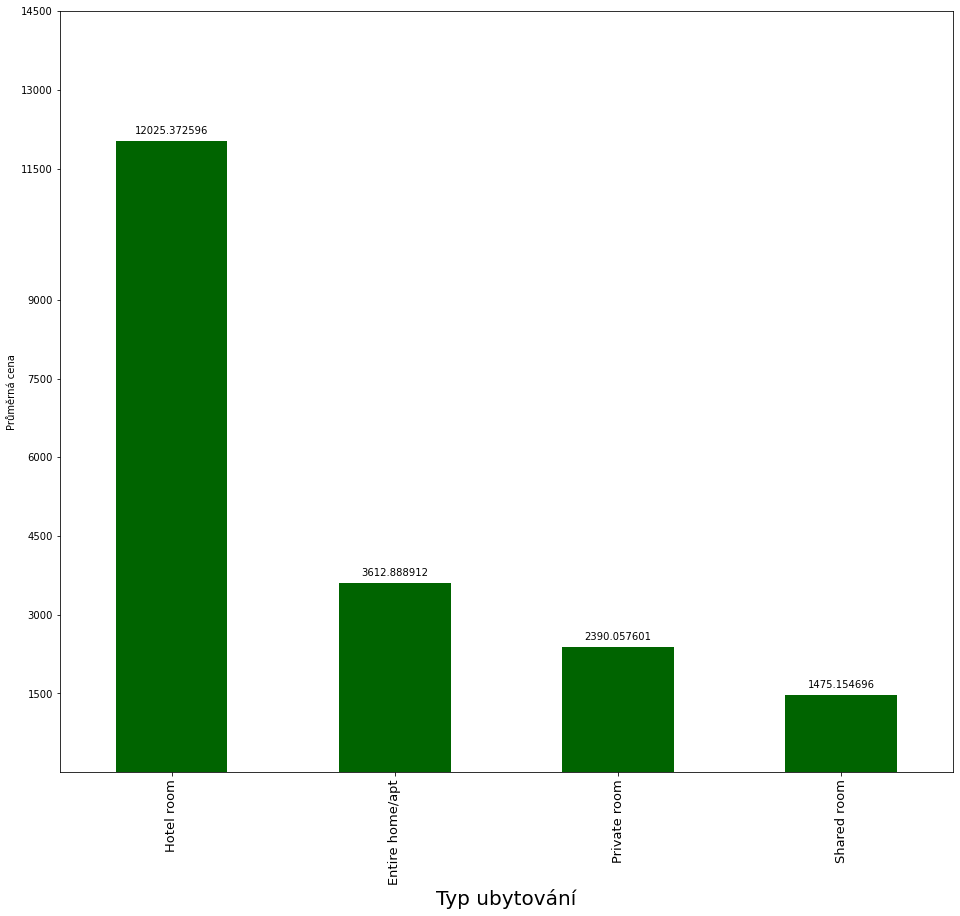

In [68]:
#ceny dle typu ubytování
fig = plt.figure(figsize=(16,14))
ax = df.groupby('RoomType').mean()['Price'].sort_values(ascending=False).plot(kind='bar',color = 'darkgreen')
plt.ylabel('Průměrná cena') 
plt.xlabel('Typ ubytování', fontsize = 20)
def barValuesFloat(ax, spacing=5):
  
    for rect in ax.patches:
        y_value = rect.get_height()
        x_value = rect.get_x() + rect.get_width() / 2
        space = spacing
        va = 'bottom'   
      
            
        label = "{:1f}".format(y_value)
        ax.annotate(
            label,                     
            (x_value, y_value),         
            xytext=(0, space),          
            textcoords="offset points", 
            ha='center',                
            va=va)  
barValuesFloat(ax)
plt.yticks([1500,3000,4500,6000,7500,9000,11500,13000,14500])
plt.xticks(fontsize = 13)
plt.savefig('PriceRoomType.png', dpi=1500)
plt.show()

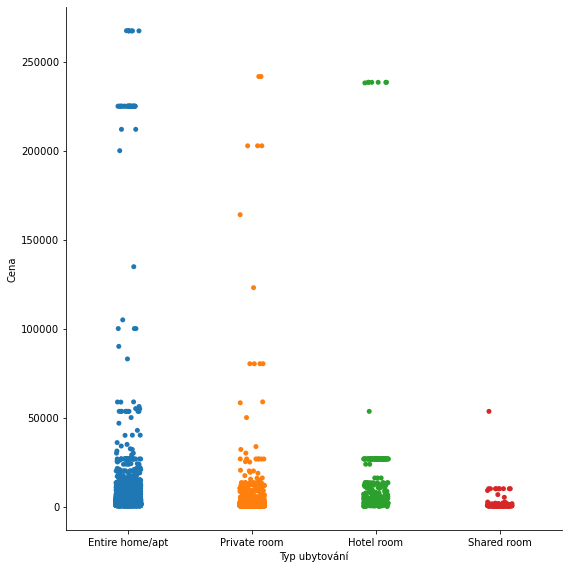

In [169]:
g = sns.catplot(x='RoomType', y='Price', data=df, height=8)
g.set_axis_labels('Typ ubytování', 'Cena')

g.savefig('PriceRoomCat.png', dpi=1500)

In [180]:
df.groupby('RoomType').describe()['Price']

,count,mean,std,min,25%,50%,75%,max
RoomType,,,,,,,,
Entire home/apt,9659.0,3612.888912,14961.055479,238.0,1071.0,1595.0,2647.0,267448.0
Hotel room,416.0,12025.372596,31199.811772,0.0,1500.0,2680.5,12041.0,238431.0
Private room,2309.0,2390.057601,11949.462275,191.0,595.0,811.0,1310.0,241694.0
Shared room,181.0,1475.154696,4478.501200,24.0,357.0,501.0,857.0,53477.0


In [184]:
df.Price.describe()

count     12565.000000
mean       3635.900915
std       15277.950644
min           0.000000
25%         952.000000
50%        1476.000000
75%        2504.000000
max      267448.000000
Name: Price, dtype: float64

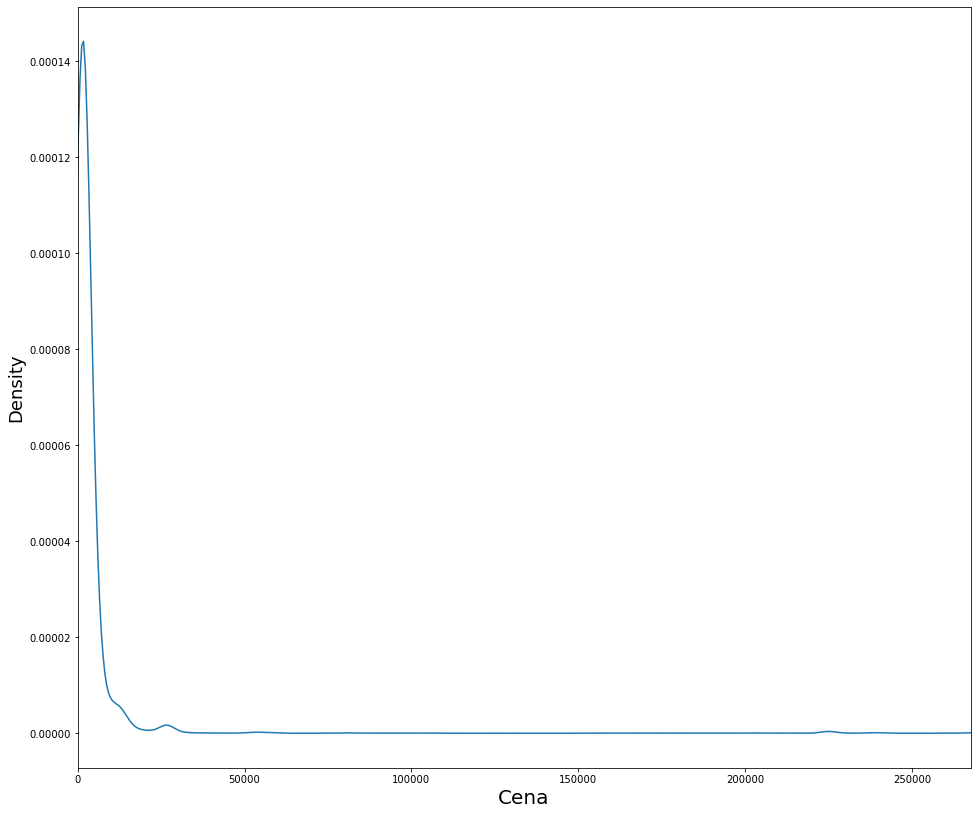

In [189]:
#distribuce ceny
fig = plt.figure(figsize=(16,14))
df['Price'].plot(kind='kde')
plt.xlim(0,267500)
plt.xlabel('Cena', fontsize = 20)
plt.ylabel('Density', fontsize = 18)
plt.savefig('priceDist.png', dpi=1500)

In [176]:
#distribuce ceny
fig = plt.figure(figsize=(16,14))
df['Price'].plot(kind='kde')
plt.xlim(0,267500)

0

No handles with labels found to put in legend.


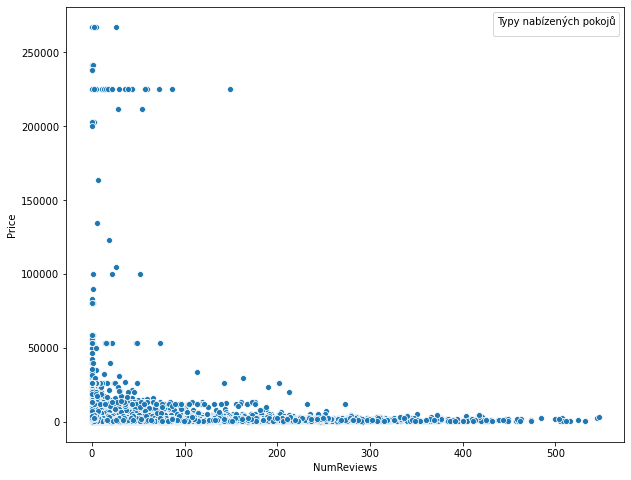

In [190]:
#Typy nabídek
plt.figure(figsize=(10,8))    
sns.scatterplot(df.NumReviews,df.Price, legend='full')
plt.legend(title='Spojitost ceny a počtu recenzí')
#plt.savefig('RoomTypesPints.png', dpi=1500)

No handles with labels found to put in legend.


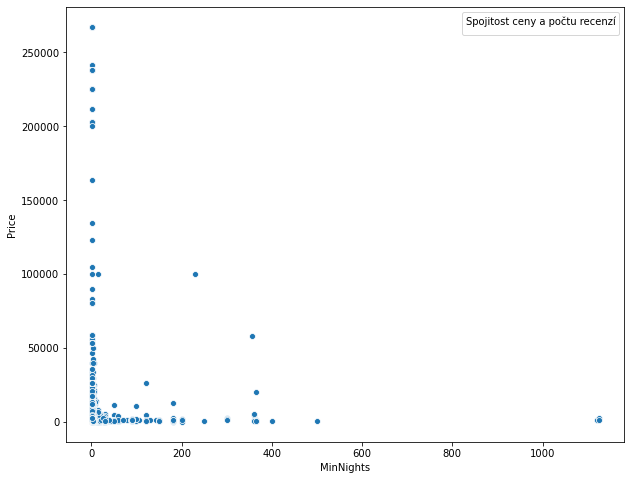

In [191]:
#Minimální počty nocí
plt.figure(figsize=(10,8))    
sns.scatterplot(df.MinNights,df.Price, legend='full')
plt.legend(title='Spojitost ceny a počtu recenzí')
#plt.savefig('RoomTypesPints.png', dpi=1500)

No handles with labels found to put in legend.


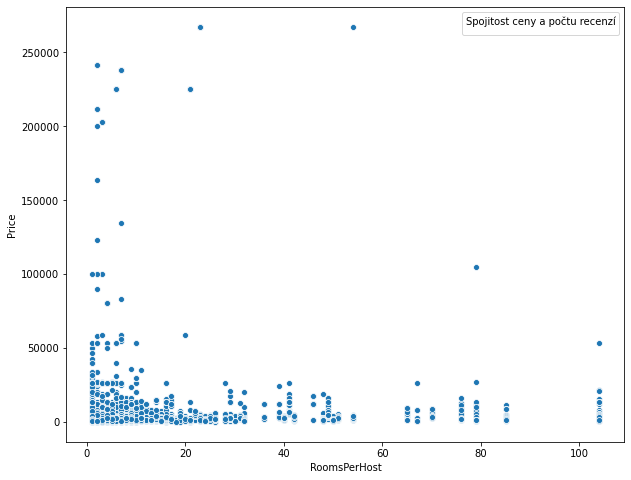

In [192]:
#Minimální počty nocí
plt.figure(figsize=(10,8))    
sns.scatterplot(df.RoomsPerHost,df.Price, legend='full')
plt.legend(title='Spojitost ceny a počtu recenzí')
#plt.savefig('RoomTypesPints.png', dpi=1500)

No handles with labels found to put in legend.


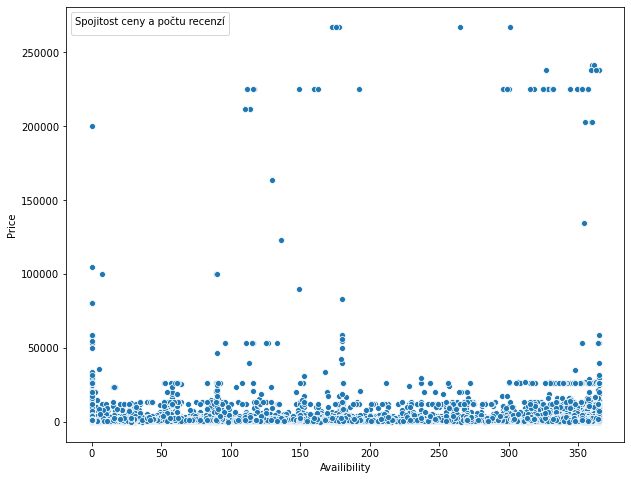

In [193]:
#Minimální počty nocí
plt.figure(figsize=(10,8))    
sns.scatterplot(df.Availibility,df.Price, legend='full')
plt.legend(title='Spojitost ceny a počtu recenzí')
#plt.savefig('RoomTypesPints.png', dpi=1500)

(0.0, 365.0)

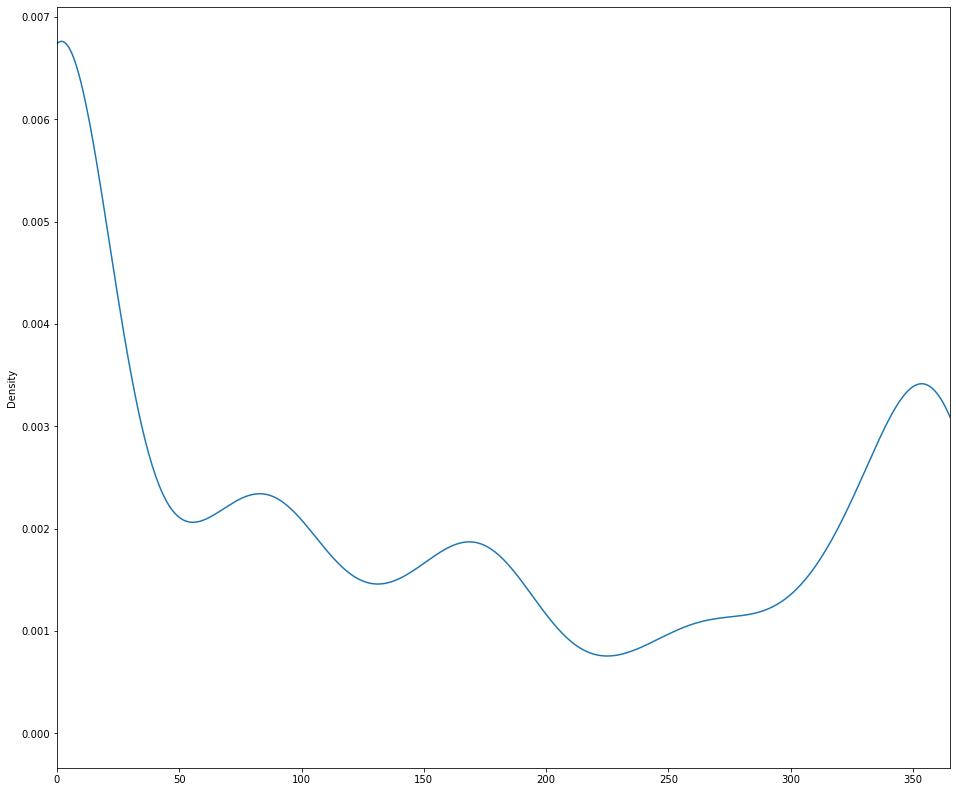

In [82]:
#distribuce hodnot ve sloupci počtu recenzí
fig = plt.figure(figsize=(16,14))
df['Availibility'].plot(kind='kde')
plt.xlim(0,df.Availibility.max())

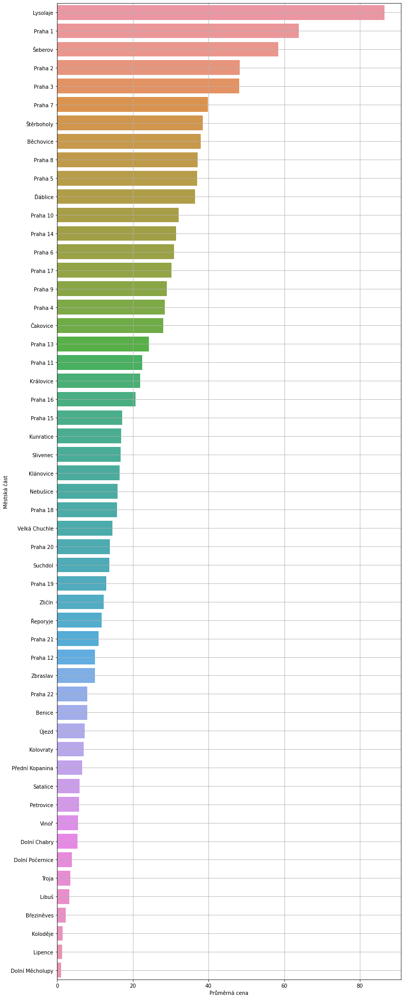

In [98]:
#průměrný počet recenzí na městskou část
cityParts = list(df['Neighbourhood'].unique())

avgReviews=[]

for i in cityParts:
    x=df[df.Neighbourhood==i]
    avgRev=sum(x.NumReviews)/len(x)
    avgReviews.append(avgRev)

df1=pd.DataFrame({'cityParts':cityParts,'avgReviews':avgReviews})
new_index=df1.avgReviews.sort_values(ascending=False).index.values
sorted_data=df1.reindex(new_index)

plt.figure(figsize=(12,35))
ax=sns.barplot(x=sorted_data.avgReviews,y=sorted_data.cityParts)
plt.grid(True)
plt.xlabel('Průměrná cena')
plt.ylabel('Městská část')
plt.savefig('CityPartsPrice.png', dpi=1500)

In [135]:
df.head(5)

,RoomID,Name,HostID,Neighbourhood,RoomType,Price,MinNights,NumReviews,RoomsPerHost,Availibility,Location,Latitude,Longtitude,PriceCategory
0,25092602,❤️AMAZING APARTMENT WITH NETFLIX NEAR CENTRE❤️,189676842,Praha 3,Entire home/apt,1310,1,79,1,172,"Czech republic, Prague, Praha 3",50.086376,14.444495,nízká
1,25197350,Room in beautiful area close to Prague Castle,28365945,Praha 6,Private room,763,1,2,1,0,"Czech republic, Prague, Praha 6",50.083104,14.369196,nízká
2,25470062,Luxury apartment in the center of Prague,47717433,Praha 2,Entire home/apt,1071,2,84,1,109,"Czech republic, Prague, Praha 2",50.073298,14.439128,nízká
3,25547218,Much More For Your Money In Beautiful Letná,21217319,Praha 7,Entire home/apt,2074,1,21,1,0,"Czech republic, Prague, Praha 7",50.102008,14.417981,střední
4,25907826,Apartment near city transport and Prague center,119497941,Praha 4,Entire home/apt,2504,1,16,1,0,"Czech republic, Prague, Praha 4",50.057750,14.450172,střední


In [112]:
df['RoomType'].unique()

array(['Entire home/apt', 'Private room', 'Hotel room', 'Shared room'],
      dtype=object)

In [127]:
df.MinNights.min()

1

In [137]:
roomTypes = list(df['RoomType'].unique())

roomPrice=[]


for i in roomTypes:
    x=df[df.RoomType==i]
    onePrice=sum((x.Price))/len(x)
    roomPrice.append(onePrice)
    print(roomPrice)


[2662.8260876750396]
[2662.8260876750396, 1958.2410322429819]
[2662.8260876750396, 1958.2410322429819, 11539.774038461539]
[2662.8260876750396, 1958.2410322429819, 11539.774038461539, 1413.4181610102603]


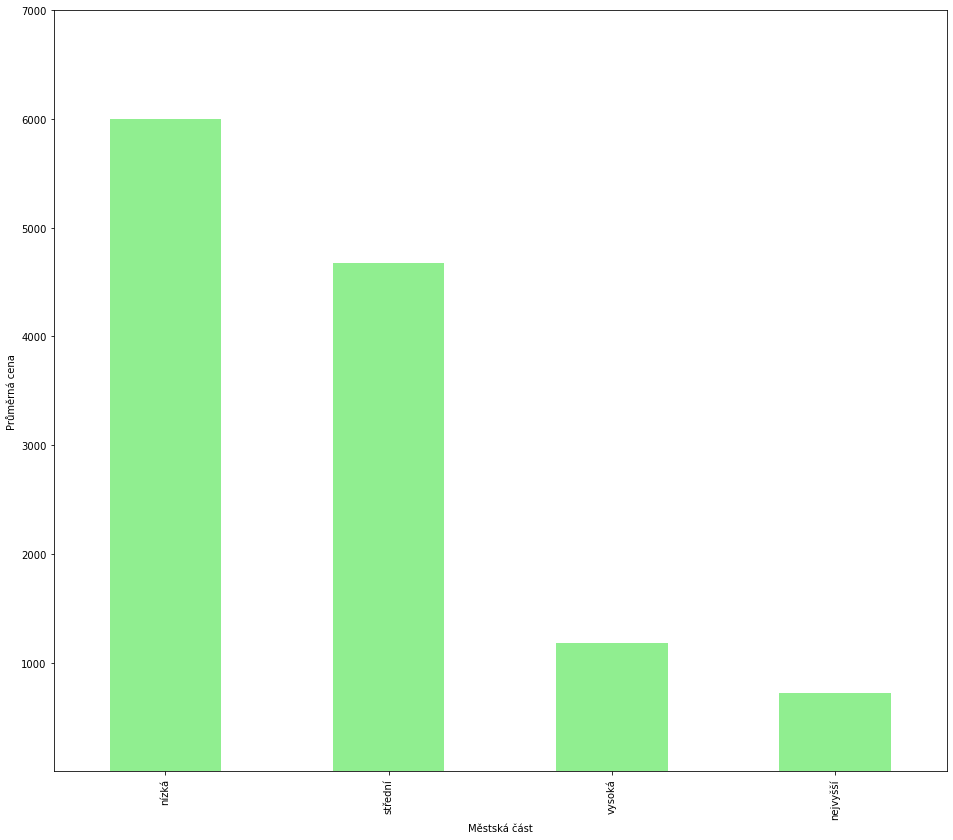

In [5]:
fig = plt.figure(figsize=(16,14))
df.PriceCategory.value_counts().sort_values(ascending=False).plot(kind='bar',color = 'lightgreen')
plt.ylabel('Počet nabídek') 
plt.xlabel('Cenová kategorie')

plt.savefig('PriceCategory.png', dpi=1500)
plt.show()

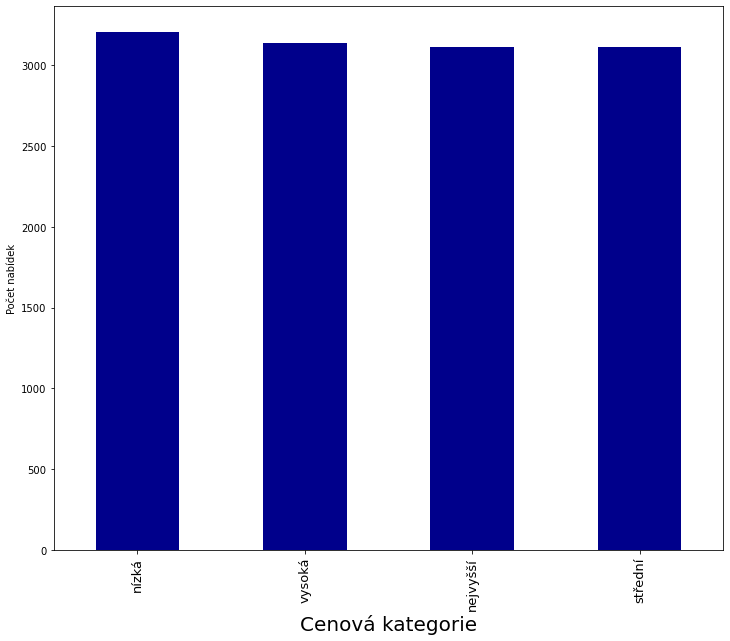

In [3]:
#počty nabídek dle cenových kategorií
fig = plt.figure(figsize=(12,10))
ax = df.PriceCategory.value_counts().sort_values(ascending=False).plot(kind='bar',color = 'darkblue')
plt.ylabel('Počet nabídek') 
plt.xlabel('Cenová kategorie', fontsize = 20)


plt.xticks(fontsize = 13)
plt.savefig('PriceCategory.png', dpi=1500)
plt.show()

In [20]:
numericDf = df[['MinNights', 'NumReviews', 'RoomsPerHost','Availibility']]


In [21]:
numericDf.describe()

,MinNights,NumReviews,RoomsPerHost,Availibility
count,12565.000000,12565.000000,12565.000000,12565.000000
mean,3.810665,46.152487,10.809471,141.382411
std,26.343038,72.624461,18.704483,139.439216
min,1.000000,0.000000,1.000000,0.000000
25%,1.000000,2.000000,1.000000,0.000000
50%,2.000000,14.000000,3.000000,90.000000
75%,2.000000,58.000000,10.000000,286.000000
max,1125.000000,547.000000,104.000000,365.000000
